# The Neuron Gorge
# https://sites.google.com/view/theneurongorge 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from skimage.io import imread, imshow

556


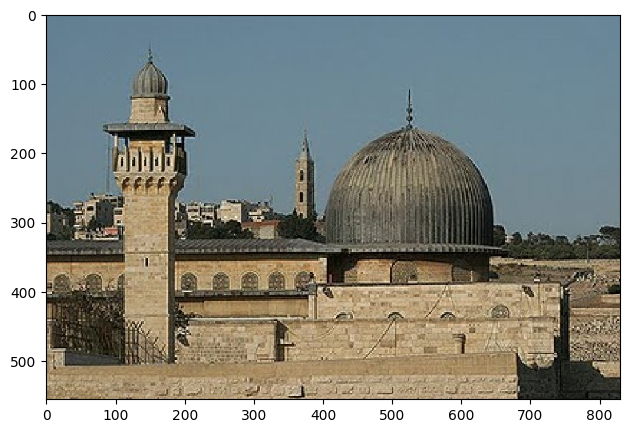

In [6]:
image1 = imread('aqsa.jpeg')
image1
imshow(image1)
print (len(image1))

[[0.47896196 0.47896196 0.47896196 ... 0.50641294 0.50641294 0.50641294]
 [0.47896196 0.47896196 0.47896196 ... 0.50641294 0.50641294 0.50641294]
 [0.47896196 0.47896196 0.47896196 ... 0.50641294 0.50641294 0.50641294]
 ...
 [0.5263451  0.53418824 0.54259686 ... 0.11456667 0.1851549  0.19299804]
 [0.53026667 0.5381098  0.54259686 ... 0.07983804 0.16611255 0.18179882]
 [0.5263451  0.52242353 0.52298902 ... 0.13866157 0.2092498  0.21709294]]


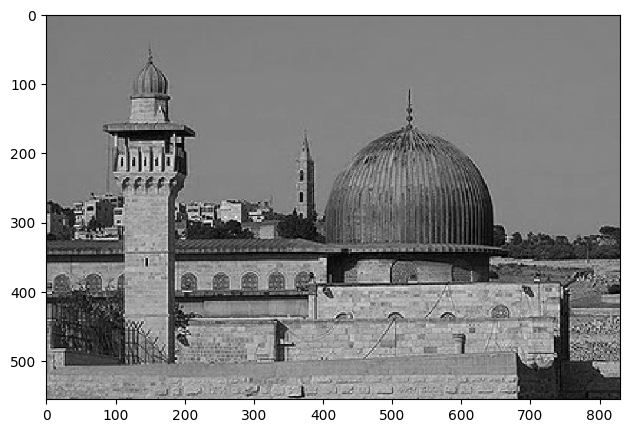

In [4]:
image2 = imread('aqsa.jpeg', as_gray=True)
imshow(image2);
print ((image2))

In [7]:
#Shape of images
print(image1.shape)
print(image2.shape)

(556, 830, 3)
(556, 830)


In [ ]:
print(image1.size)
print(image2.size)

1384440
461480


**Feature extraction**

1. Pixel Features

In [8]:
pixel_feat = np.reshape(image2, (556 * 830))
pixel_feat

array([0.47896196, 0.47896196, 0.47896196, ..., 0.13866157, 0.2092498 ,
       0.21709294])

In [9]:
pixel_feat2 = np.reshape(image1, (556 * 830 * 3))
pixel_feat2

array([ 98, 127, 145, ...,  54,  56,  53], dtype=uint8)

2. Edge Features

### Previt kernel

* Prewitt Horizontal Kernel:

[ -1 -1 -1 ] <br>
[  0   0   0 ] <br>
[  1   1   1 ]

In [10]:
from skimage import filters
from skimage import feature
from skimage.filters import prewitt_h,prewitt_v
# prewitt kernel
pre_hor = prewitt_h(image2)


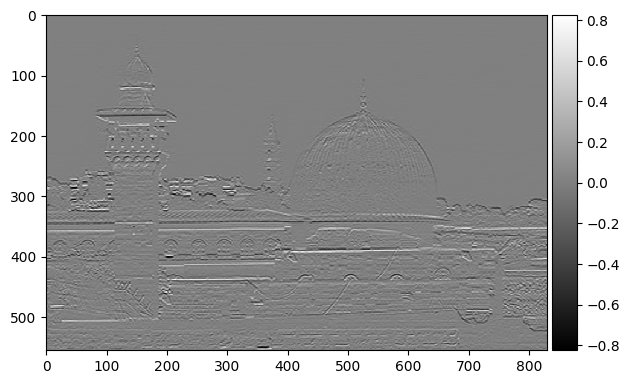

In [14]:
imshow(pre_hor, cmap='gray');
# imshow(pre_hor);

* Prewitt Vertical Kernel:

[ -1  0  1 ] <br>
[ -1  0  1 ] <br>
[ -1  0  1 ]

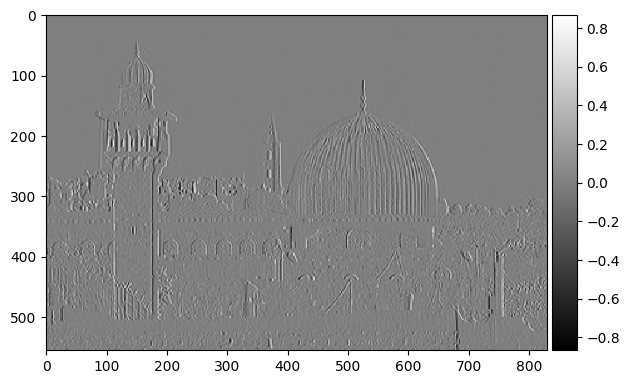

In [17]:
pre_ver = prewitt_v(image2)
imshow(pre_ver, cmap='gray')

* Sobel Operator Vertical

[ -1  0  1 ] <br>
[ -2  0  2 ] <br>
[ -1  0  1 ]

* Sobel Operator Horizontal

[ -1  -2  -1 ] <br>
[  0  0  0 ] <br>
[ 1  2  1 ]

In [18]:
# Sobel Kernel
ed_sobel = filters.sobel(image2)


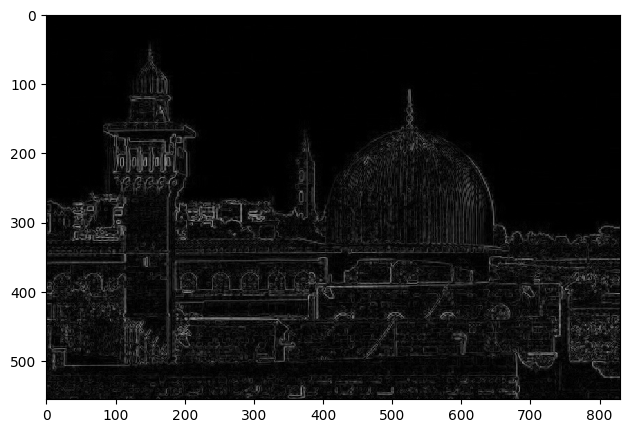

In [19]:
imshow(ed_sobel, cmap='gray');

In [20]:
#canny algorithm
can = feature.canny(image2)
can

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ...,  True, False, False],
       [False, False, False, ...,  True, False, False],
       [False, False, False, ..., False, False, False]])

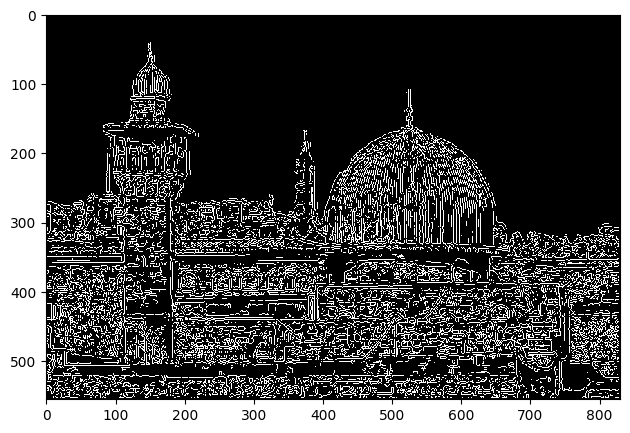

In [21]:
imshow(can, cmap='gray')

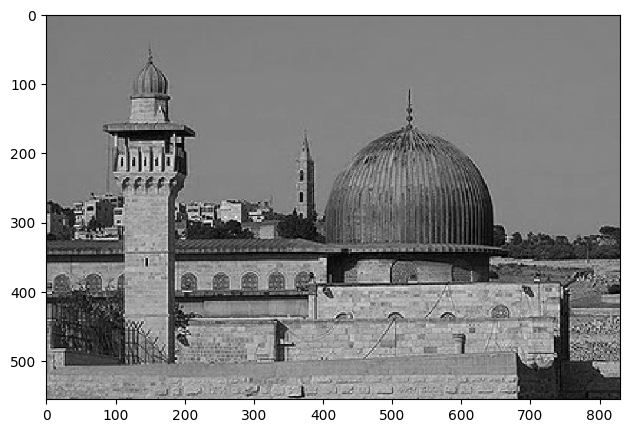

In [93]:
from skimage import color
grayscale = color.rgb2gray(image1)

imshow(grayscale)
plt.show()

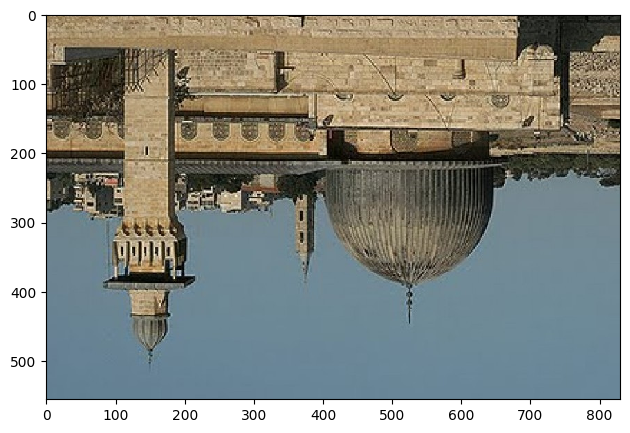

In [28]:
# Flip the image in up direction
verticalflip = np.flipud(image1)

imshow(verticalflip)
plt.show()

(256, 128, 3)


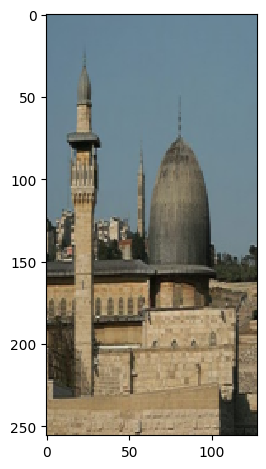

In [34]:
from skimage.transform import resize
resized_img = resize(image1, (256,128))
imshow(resized_img)
print(resized_img.shape)

In [ ]:
# resized_img=image1

In [42]:
from skimage.feature import hog
from skimage import exposure
#creating hog features
fd, hog_image = hog(resized_img, orientations=9, pixels_per_cell=(8, 8),
                    cells_per_block=(2, 2), visualize=True, multichannel=True)

<ipython-input-42-eb0b24726d68>:4: FutureWarning: `multichannel` is a deprecated argument name for `hog`. It will be removed in version 1.0. Please use `channel_axis` instead.
  fd, hog_image = hog(resized_img, orientations=9, pixels_per_cell=(8, 8),


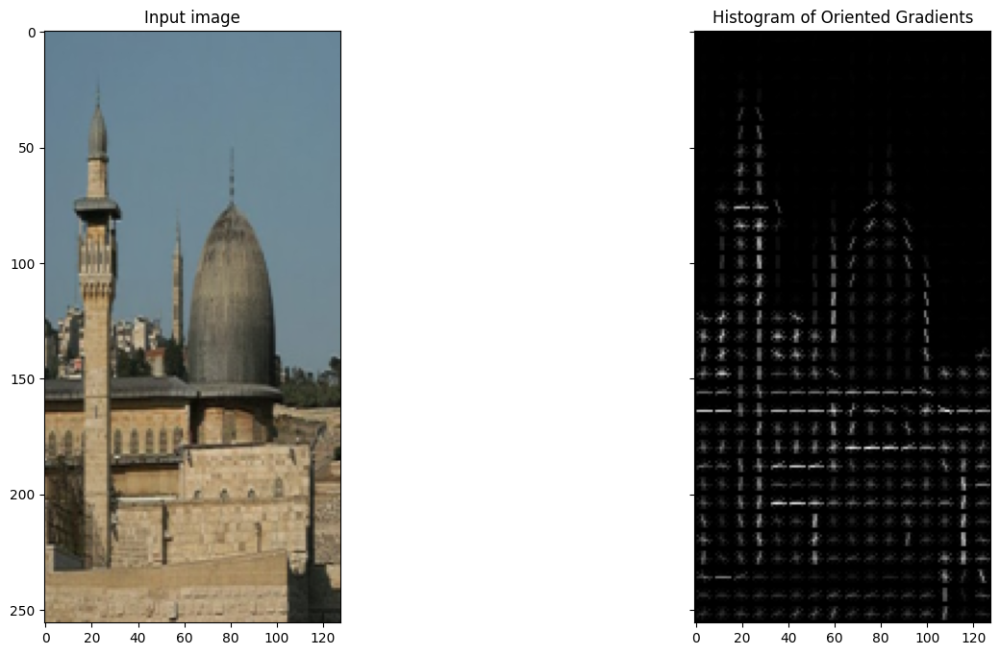

In [43]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8), sharex=True, sharey=True)

ax1.imshow(resized_img, cmap=plt.cm.gray)
ax1.set_title('Input image')

# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
ax2.set_title('Histogram of Oriented Gradients')

plt.show()

In [44]:
++feature vector+
fd

SyntaxError: ignored

In [45]:
!pip install opencv-python

In [48]:
import cv2
from google.colab.patches import cv2_imshow

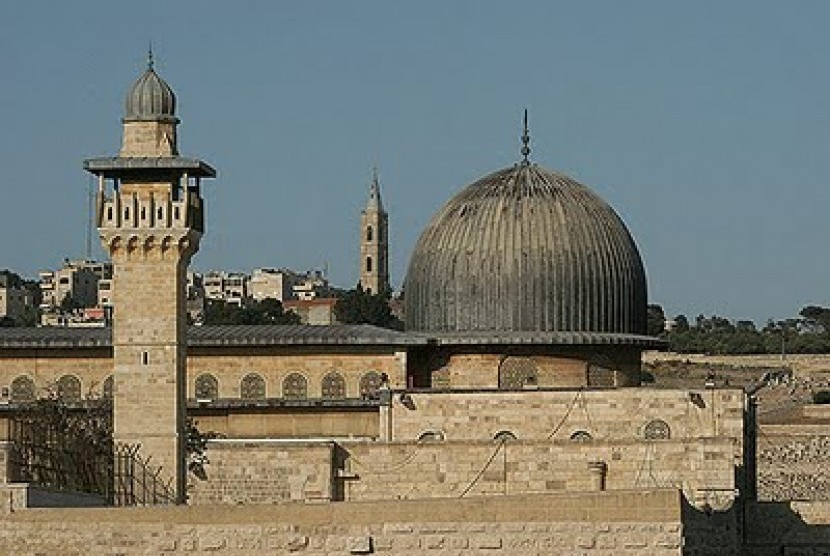

In [55]:

image = cv2.imread('aqsa.jpeg')
cv2_imshow(image)

cv2.waitKey(0)
cv2.destroyAllWindows()

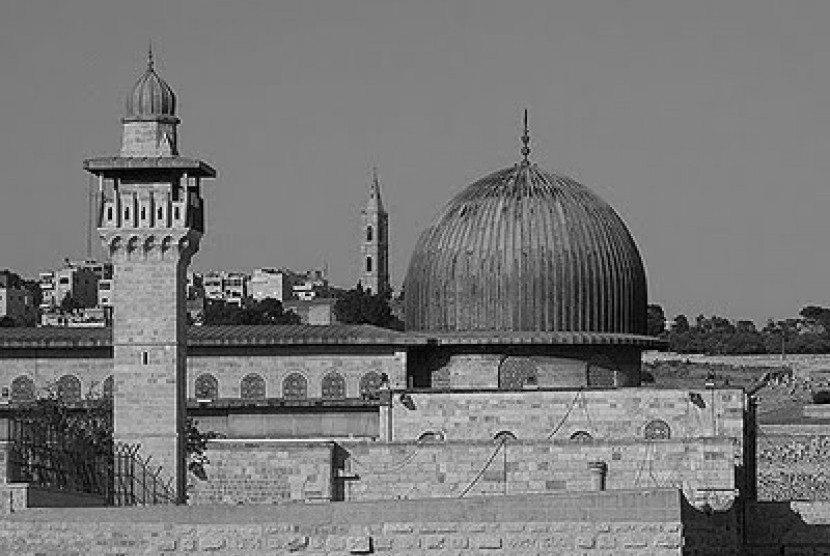

In [57]:
# Display the grayscale image
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

cv2_imshow(gray_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

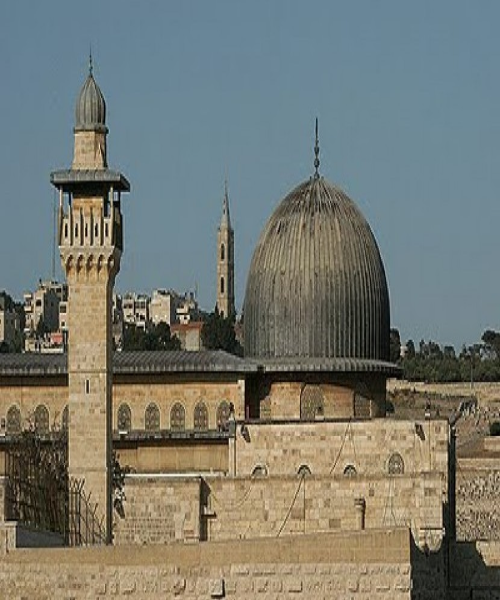

In [60]:
new_width = 500
new_height = 600

resized_image = cv2.resize(image, (new_width, new_height))

cv2_imshow(resized_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [61]:
cv2.imwrite('new_image.jpg', resized_image)

True

### Gausian Kernel

[1 2 1]<br>
[2 4 2]<br>
[1 2 1]

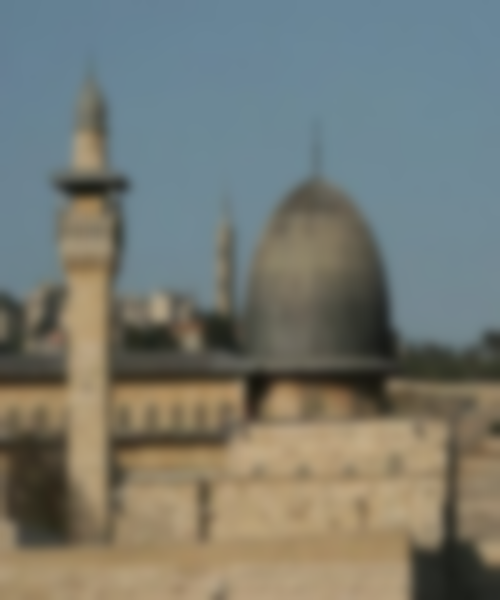

In [97]:
blurred_image = cv2.GaussianBlur(resized_image, (35,35), 0)

# Display the blurred image
cv2_imshow( blurred_image)
cv2.waitKey(0)
cv2.destroyAllWindows()


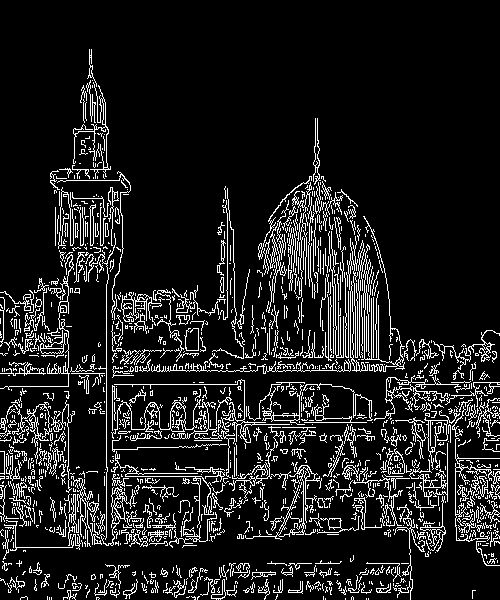

In [67]:
gray_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)

edges = cv2.Canny(gray_image, 100, 200)
cv2_imshow(edges)
cv2.waitKey(0)
cv2.destroyAllWindows()

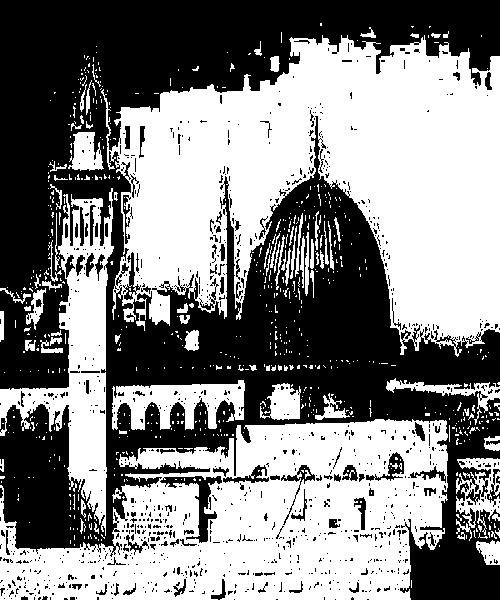

In [69]:
gray_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)

# Apply binary thresholding (adjust the threshold value as needed)
_, binary_image = cv2.threshold(gray_image, 128, 255, cv2.THRESH_BINARY)

cv2_imshow( binary_image)
cv2.waitKey(0)
cv2.destroyAllWindows()


### Detect faces

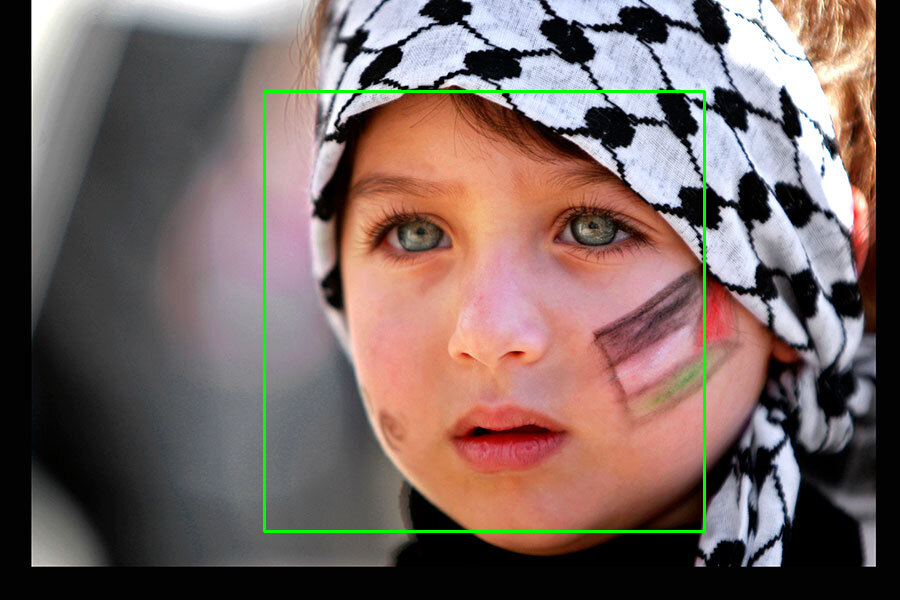

In [78]:
import cv2

image = cv2.imread('kid.jpg')
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

faces = face_cascade.detectMultiScale(gray_image, scaleFactor=1.1, minNeighbors=1, minSize=(300, 300))

for (x, y, w, h) in faces:
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

cv2_imshow( image)
cv2.waitKey(0)
cv2.destroyAllWindows()

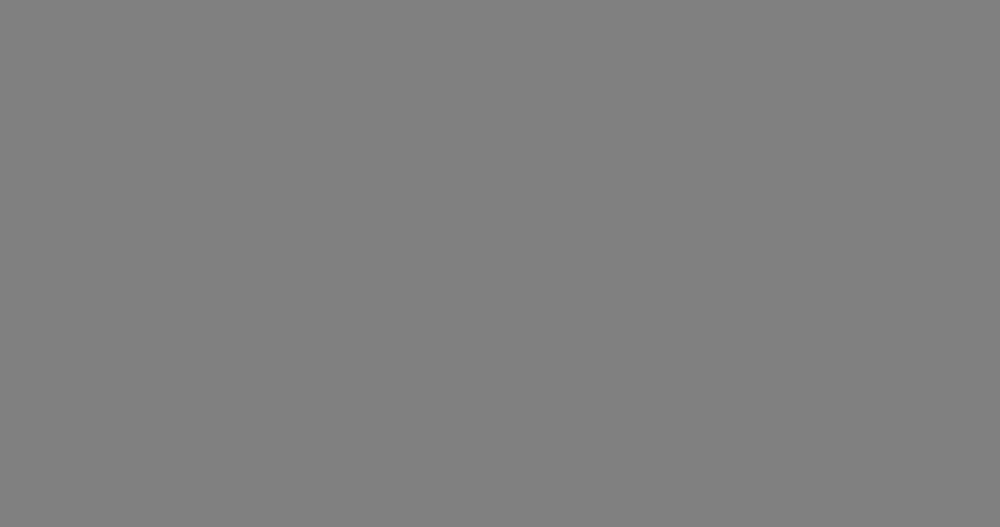

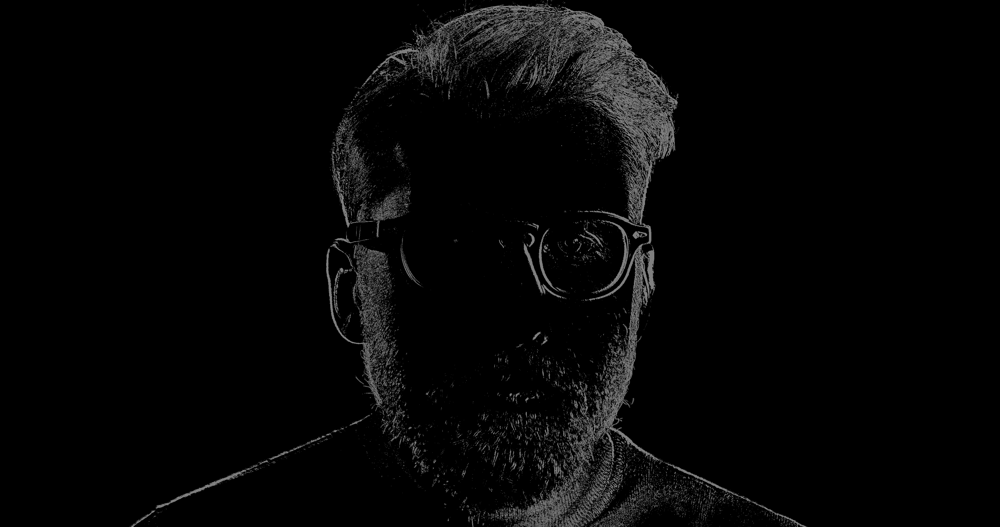

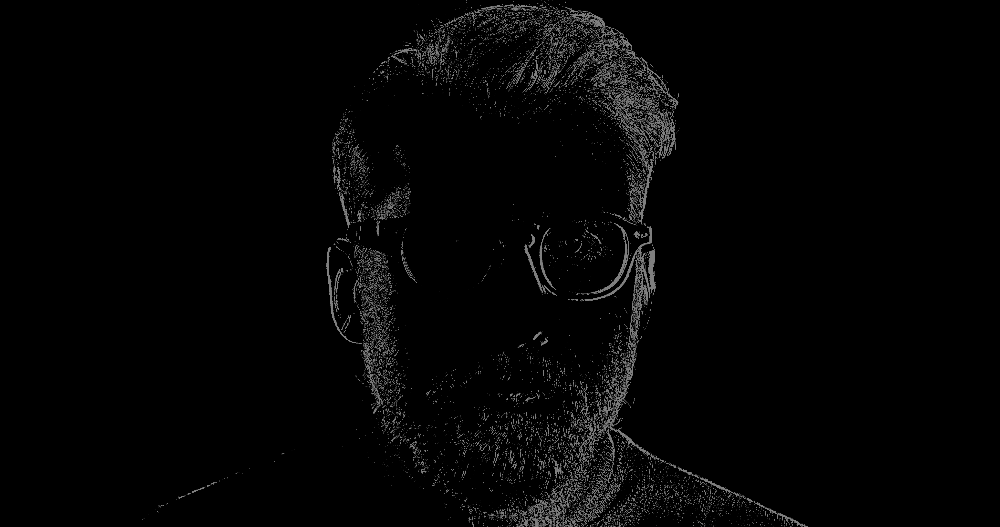

In [4]:
import cv2

bg_subtractor = cv2.createBackgroundSubtractorMOG2()

cap = cv2.VideoCapture('video.mp4')

while True:
    ret, frame = cap.read()
    if not ret:
        break

    fg_mask = bg_subtractor.apply(frame)


    cv2_imshow( fg_mask)

    if cv2.waitKey(30) & 0xFF == 27:
        break

cap.release()
cv2.destroyAllWindows()

# Lab Tasks

1. Read an image and convert it to grey scale. Apply sobel kernel using opencv and from scratch (vertical).
3. Apply gausian filter kernal to blur an image from scratch and opencv (Use RGB image and 3x3 gausian kernel).
4. Upload a group image and all detect faces in it (5 people at least).
5. Upload a video of people preferably walking of people count how many occurances of people are in it (if the person's face is appearing at +20 or -20 pixels from center in consective frames then assume it as same person).
6. Upload a video and apply gausian kernal on it in frames where a face is appeared.
7. Upload a video and apply canny edge detector on it in frames where there is no frame.

In [11]:
from google.colab.patches import cv2_imshow

In [12]:
from skimage import filters
from skimage import feature
from skimage.filters import prewitt_h,prewitt_v
from skimage import color
import numpy as np

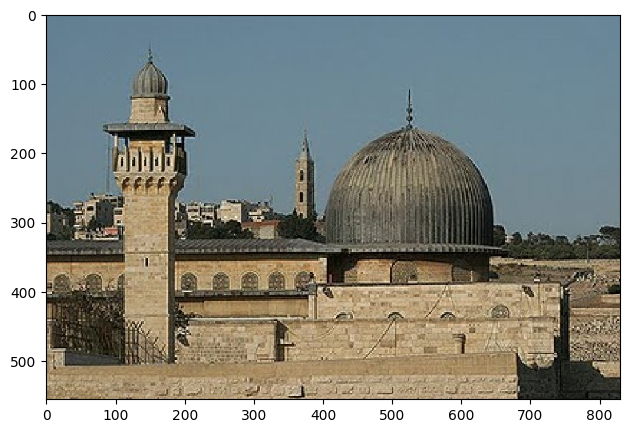

In [105]:
img1 = imread('aqsa.jpeg')
img2 = color.rgb2gray(image1)
imshow(img1)

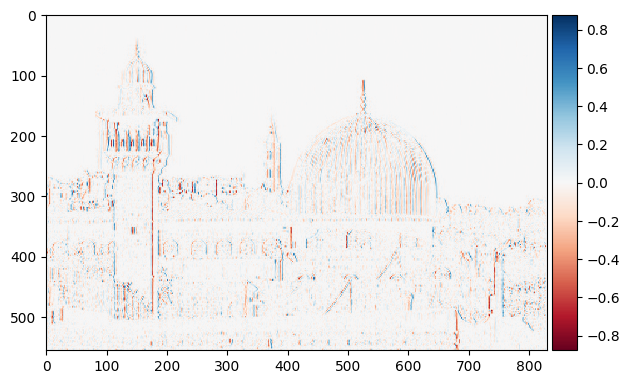

In [96]:
sobel_img = filters.sobel_v(img2)

imshow(sobel_img)

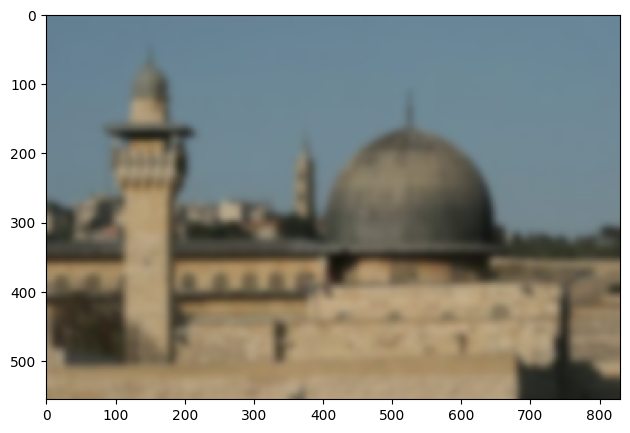

In [174]:
blurred_image = cv2.GaussianBlur(img1, (35,35), 0)

imshow( blurred_image)

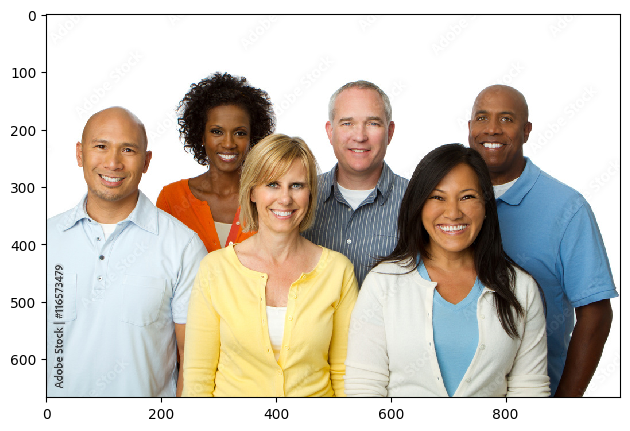

In [206]:
img1 = imread('ajeeb.jpg')
# img2 = color.rgb2gray(img1)

imshow(img1)

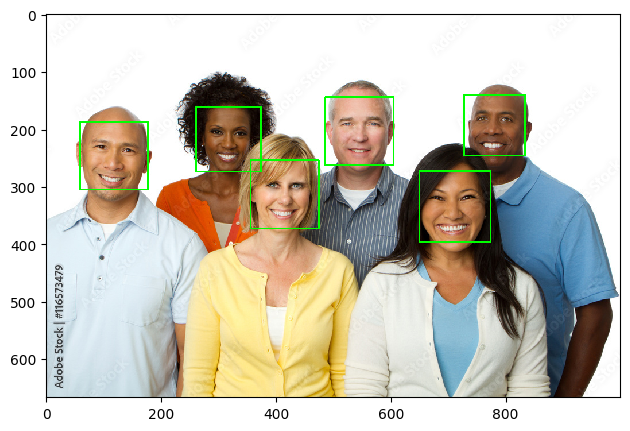

In [207]:

face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

faces = face_cascade.detectMultiScale(img1, scaleFactor=1.1, minNeighbors=1, minSize=(100, 100))

for (x, y, w, h) in faces:
    cv2.rectangle(img1, (x, y), (x + w, y + h), (0, 255, 0), 2)

imshow( img1)

In [149]:
# Scratch
# Task 1
img1 = imread('aqsa.jpeg')
img2 = color.rgb2gray(image1)
sobel_kernal = np.array([[-1, 0, 1], [-2, 0 ,2], [-1, 0, 1]])

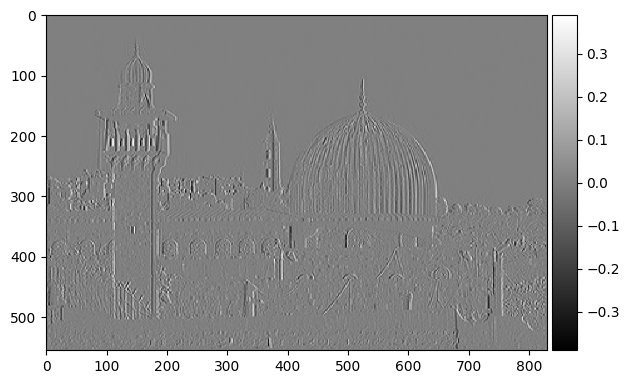

In [152]:
sum = 0
gradient = 0
new_img = np.zeros_like(img2)

for i in range((img2.shape[0])-2):
  for j in range((img2.shape[1])-2):
    sum = 0
    for k in range(i, i+3):
      for l in range(j, j+3):
        sum += sobel_kernal[k-i][l-j] * img2[k][l]

    gradient = sum / 9
    new_img[i][j] = gradient

imshow(new_img, cmap='gray')



In [171]:
# Task 2

img1 = imread('aqsa.jpeg')
img2 = color.rgb2gray(image1)
blur_kernal = np.array([[1, 2, 1], [2, 4 ,2], [1, 2, 1]])

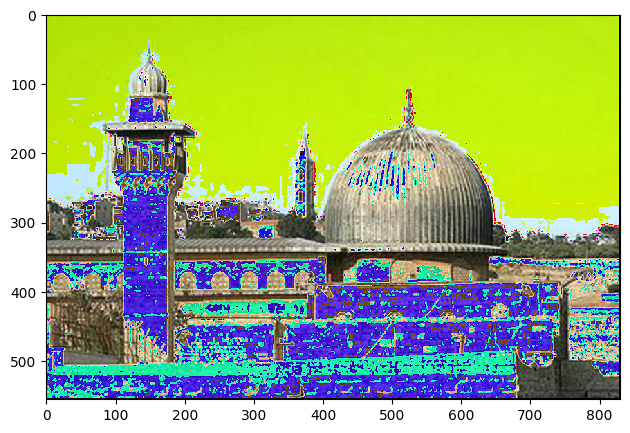

In [181]:
sum = 0
gradient = 0
new_img = np.zeros_like(img1)

for c in range(3):
  for i in range((img1.shape[0])-2):
    for j in range((img1.shape[1])-2):
      sum = 0
      for k in range(i, i+3):
        for l in range(j, j+3):
          sum += blur_kernal[k-i][l-j] * img1[k][l][c]

      gradient = sum / 9
      new_img[i][j][c] = gradient

# imshow(new_img, cmap='gray')
imshow(new_img)

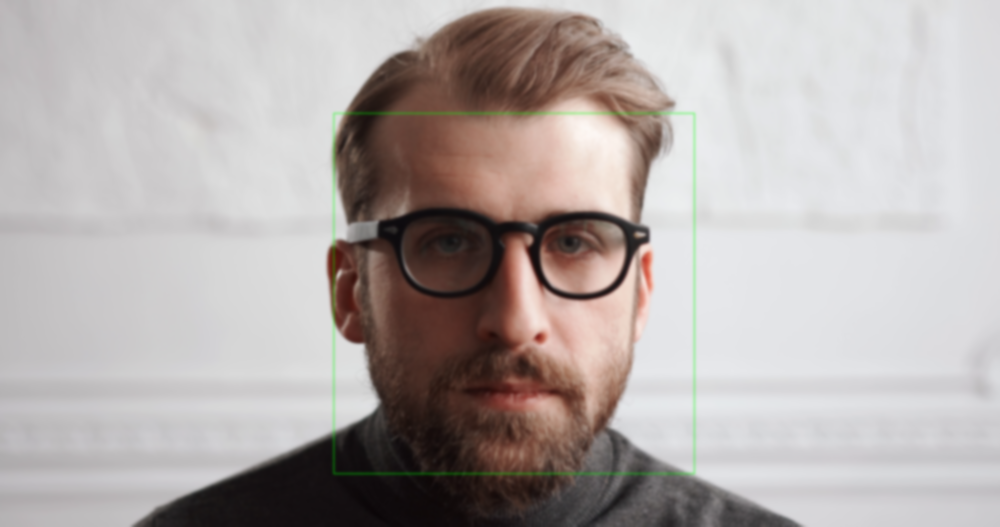

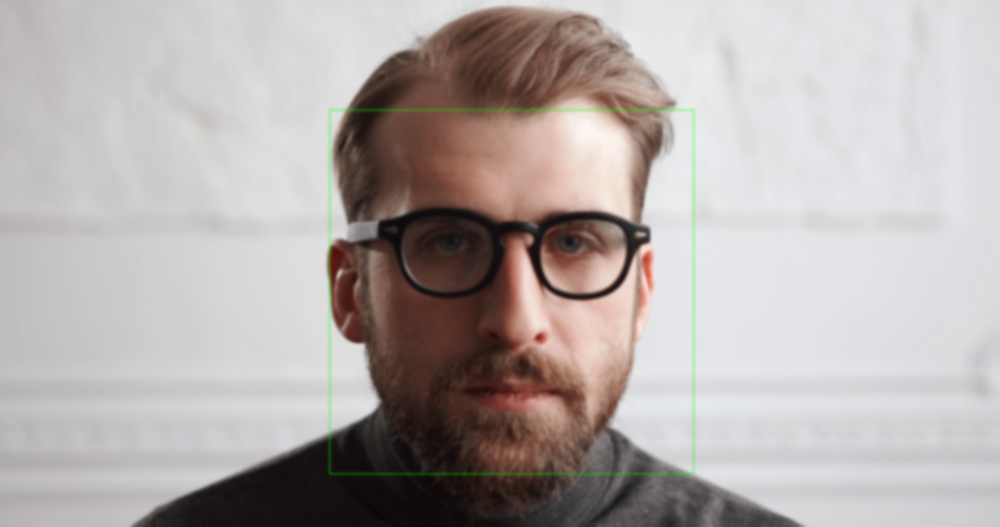

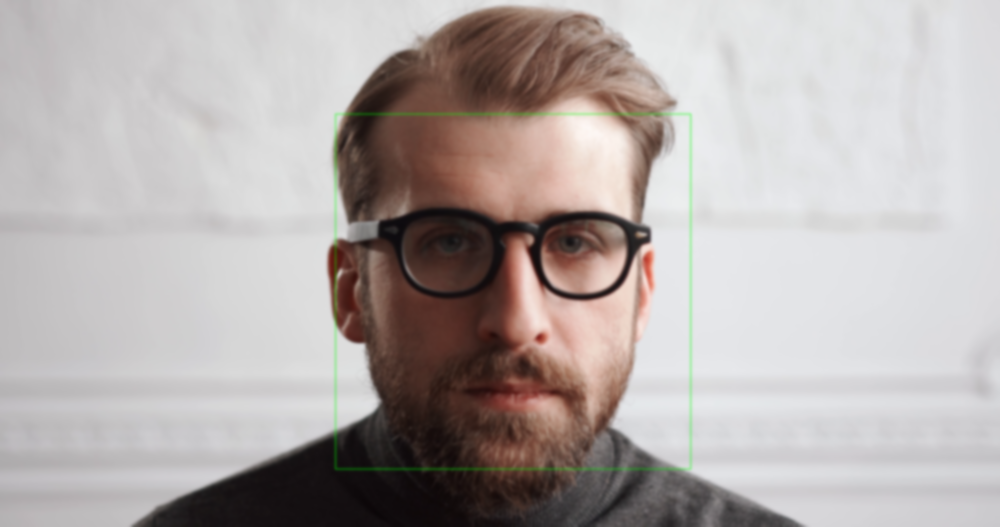

In [14]:
import cv2

bg_subtractor = cv2.createBackgroundSubtractorMOG2()

cap = cv2.VideoCapture('video.mp4')

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # fg_mask = bg_subtractor.apply(frame)
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
    faces = face_cascade.detectMultiScale(frame, scaleFactor=1.1, minNeighbors=1, minSize=(100, 100))

    if len(faces) > 0:

      for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

    if len(faces) > 0:
      blurred_image = cv2.GaussianBlur(frame, (35,35), 0)

      # imshow( blurred_image)


      cv2_imshow( blurred_image)



    if cv2.waitKey(30) & 0xFF == 27:
        break

cap.release()
cv2.destroyAllWindows()

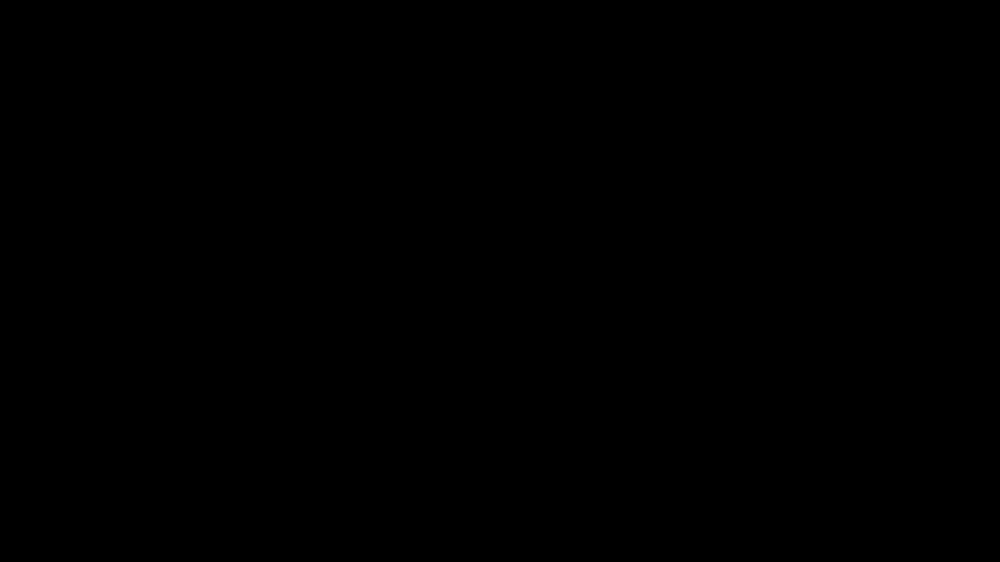

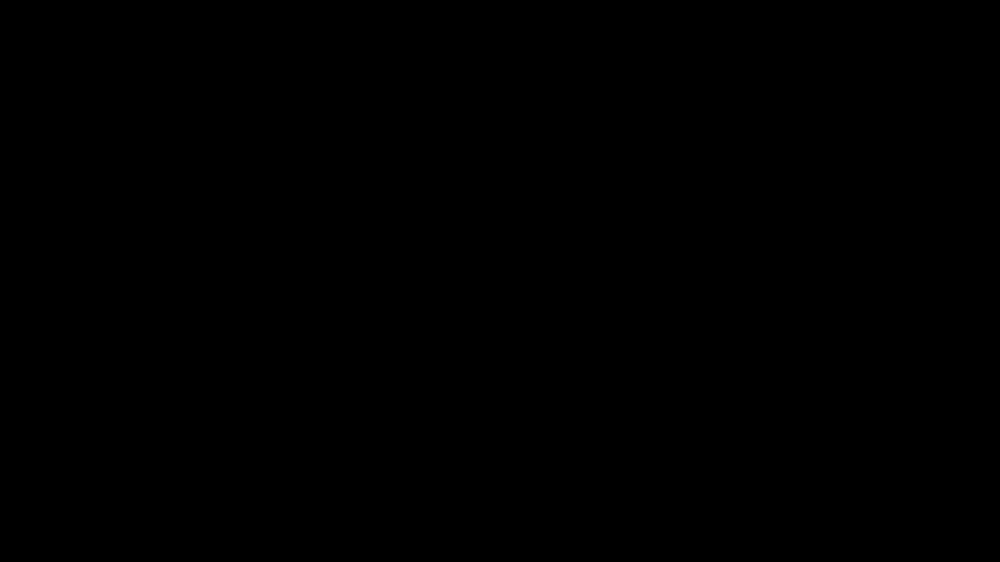

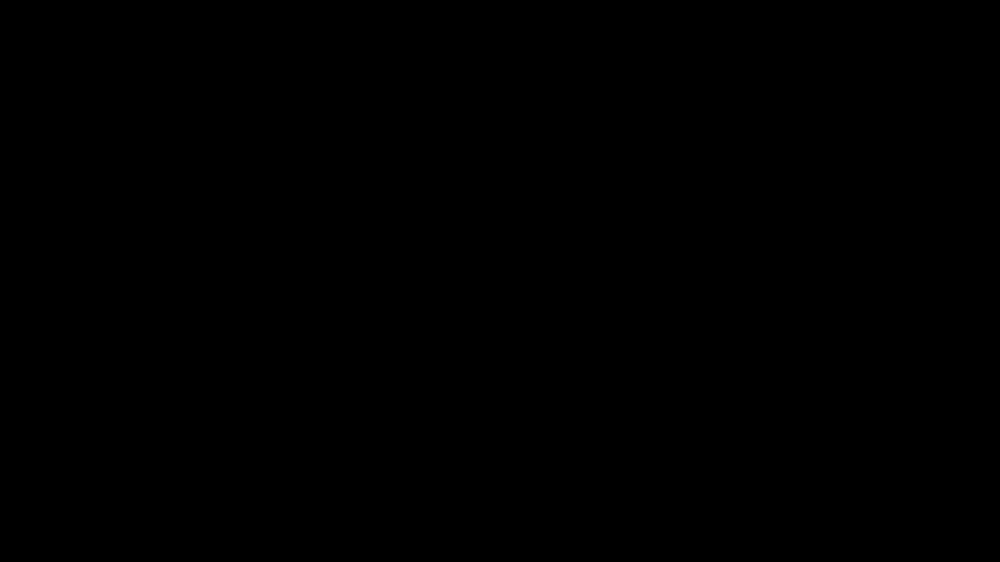

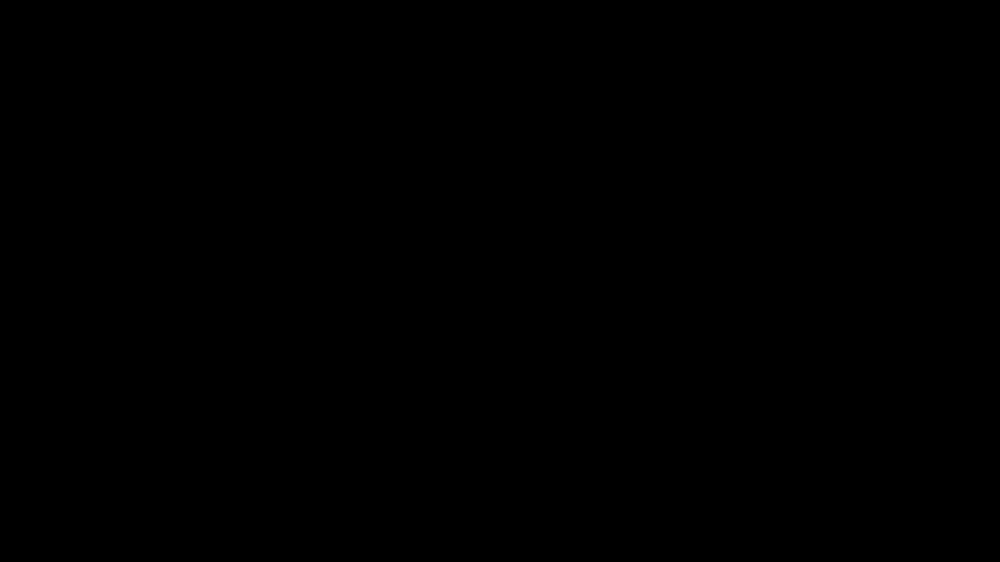

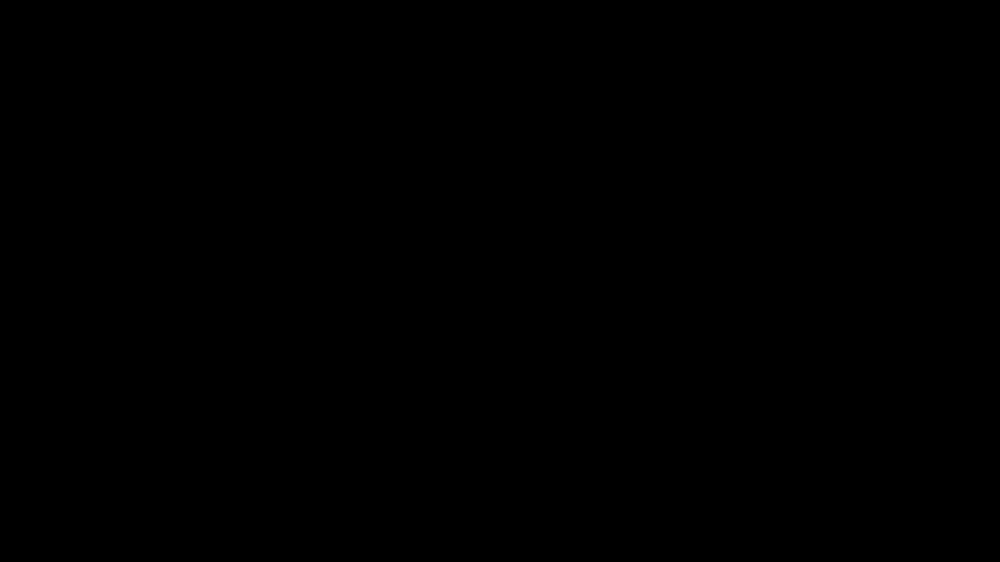

...

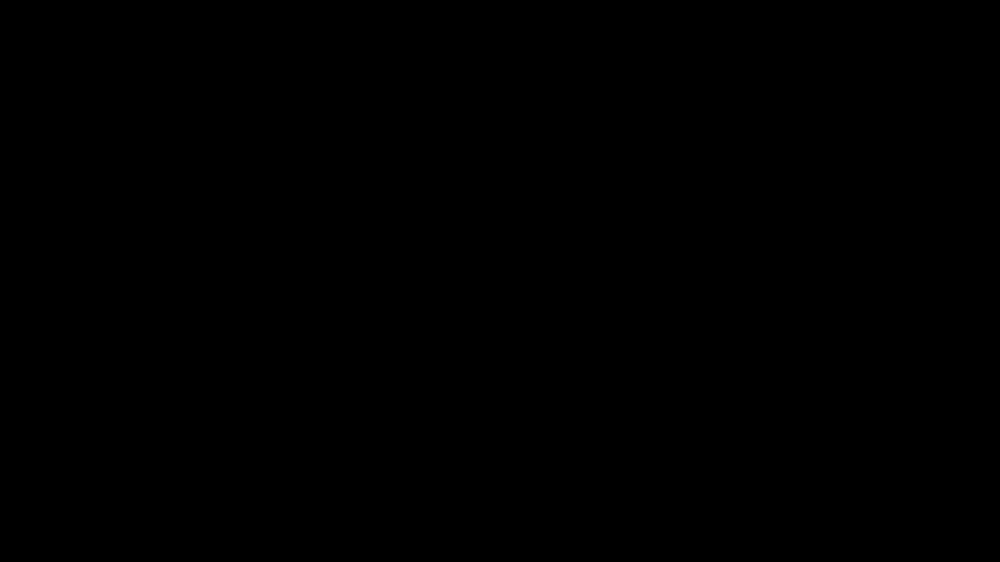

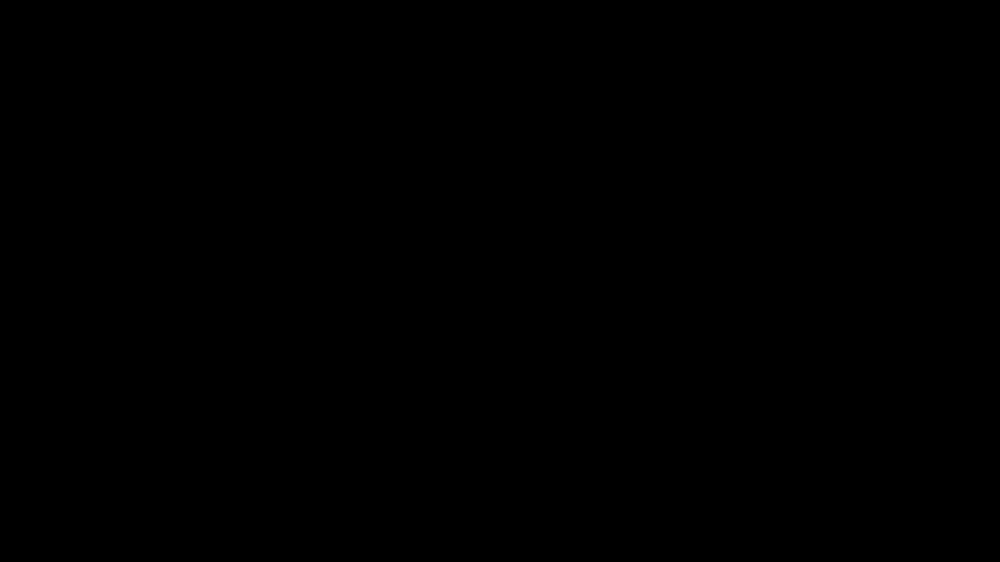

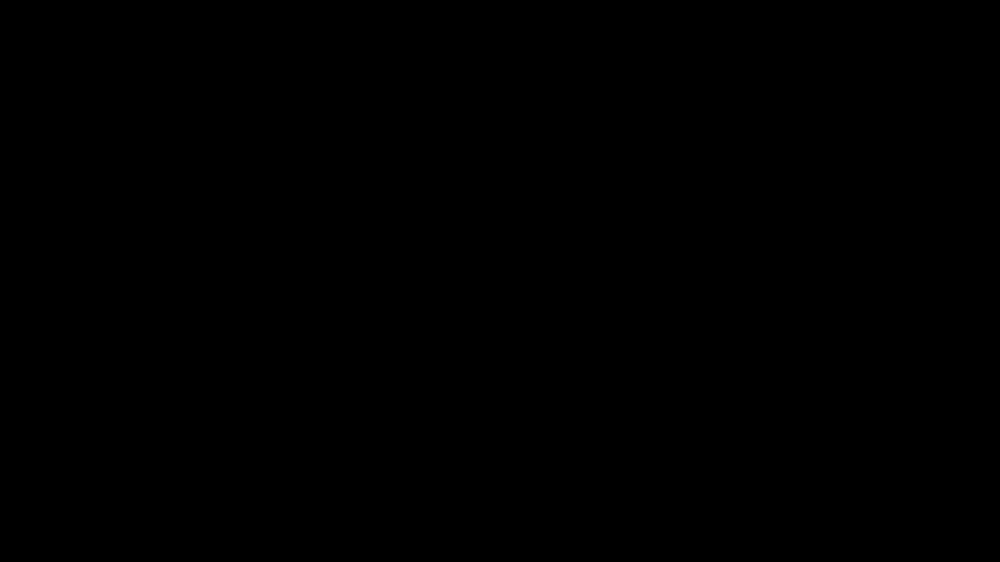

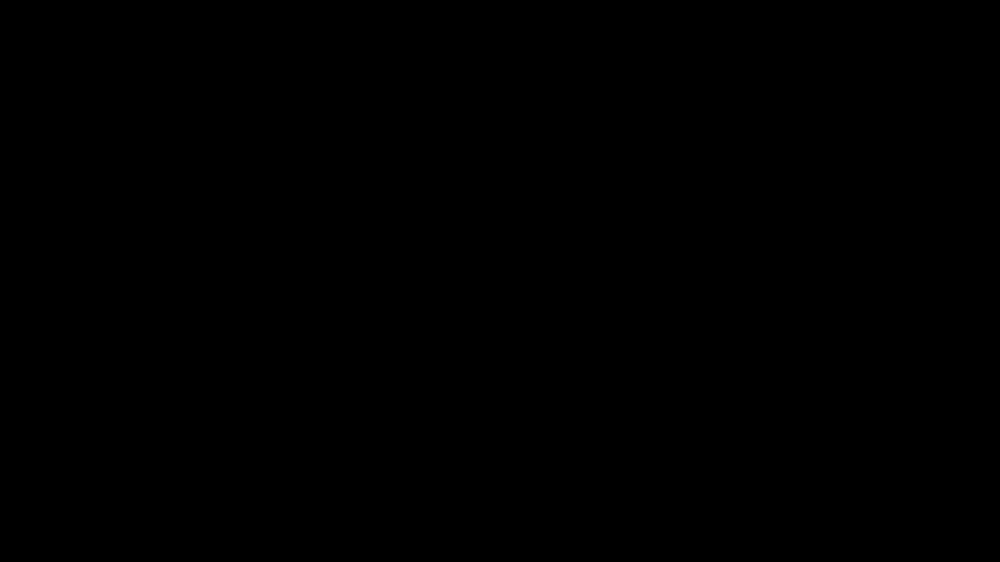

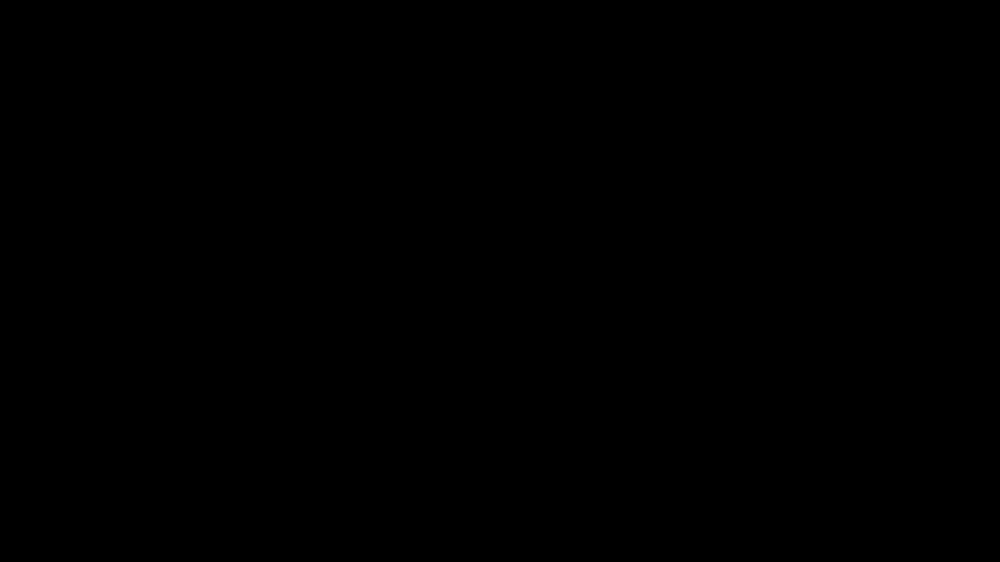

In [18]:
import cv2

bg_subtractor = cv2.createBackgroundSubtractorMOG2()

cap = cv2.VideoCapture('catvid.mp4')

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # fg_mask = bg_subtractor.apply(frame)
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
    faces = face_cascade.detectMultiScale(frame, scaleFactor=1.1, minNeighbors=1, minSize=(100, 100))

    if len(faces) == 0:
      gray_image = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

      edges = cv2.Canny(gray_image, 100, 200)
      cv2_imshow(edges)




    if cv2.waitKey(30) & 0xFF == 27:
        break

cap.release()
cv2.destroyAllWindows()